## Mapa de Galicia que mostra as provincias, cos distintos camiños que van a Santiago e no que represento a rede de albergues agrupada por clústers

In [1]:
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import folium
import folium.plugins
import requests

## Cargo o archivo de concellos de Galicia para crear o mapa de Galicia. O archivo pode descargarse da páxina do sergas

In [2]:
df_concello = gpd.read_file('../../datasets/Concellos/Concellos_IGN.shp')
df_concello.head()




,NomeConcel,CodCONC,Concello,CodCOM,CodPROV,NomeCapita,Comarca,Provincia,CODIGOINE,NomeMAY,Shape_Leng,Shape_Area,VALOR,geometry
0,Sarreaus,32078.0,Sarreaus,32.0,32.0,Sarreaus,A Limia,Ourense,32078,SARREAUS,40754.205361,7.725592e+07,NaN,"POLYGON ((608813.195 4664453.146, 608701.934 4..."
1,Taboadela,32079.0,Taboadela,37.0,32.0,Taboadela,Ourense,Ourense,32079,TABOADELA,23378.040256,2.517205e+07,NaN,"POLYGON ((593815.346 4676211.812, 593751.767 4..."
2,A Bola,32014.0,"Bola, A",39.0,32.0,"Bola, A",Terra De Celanova,Ourense,32014,A BOLA,25533.370597,3.488287e+07,NaN,"POLYGON ((588198.821 4663569.770, 588204.697 4..."
3,Maside,32045.0,Maside,35.0,32.0,Maside,O Carballiño,Ourense,32045,MASIDE,27891.138676,4.001874e+07,NaN,"POLYGON ((577375.148 4694642.899, 577328.854 4..."
4,Trasmiras,32082.0,Trasmiras,32.0,32.0,Trasmiras,A Limia,Ourense,32082,TRASMIRAS,38334.093117,5.670926e+07,NaN,"POLYGON ((613123.723 4648827.622, 613103.413 4..."


epsg:25829


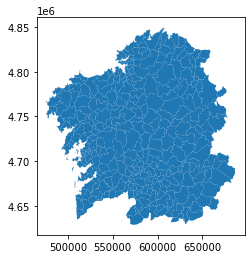

In [3]:
df_concello.plot()
print(df_concello.crs)

## Cargo os datos dos camiños de Santiago obtidos na páxina do sergas, camiño frances, inglés e norte, o archivo dos camiños portugués, vía da prata e fisterra obtívenos noutra web, polo que comprobo o seu crs

In [4]:
df_camiño_ingles = gpd.read_file('../../datasets/camiño/Camiño_Ingles/25829/SHP/AMBITO.shp')
color = 'black'
df_camiño_ingles['color'] = color
df_camiño_ingles



,AMBITO,Shape_Area,geometry,color
0,AMBITO CAMIÑO INGLÉS,4.779299e+07,"POLYGON ((548992.072 4798920.976, 548989.338 4...",black
1,AMBITO CAMIÑO INGLÉS,1.259252e+07,"POLYGON ((564249.474 4792279.832, 564248.284 4...",black


epsg:25829


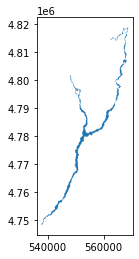

In [5]:
df_camiño_ingles.plot()
print(df_camiño_ingles.crs)

In [6]:
df_camiño_nortecosta = gpd.read_file('../../datasets/camiño/Camiño_Norte_Costa/25829/SHP/Territorio_historico.shp')
color = 'red'
df_camiño_nortecosta['color'] = color
df_camiño_nortecosta



,NUMERODUP,geometry,color
0,None,"MULTIPOLYGON (((616961.951 4798021.522, 616965...",red
1,None,"POLYGON ((568745.188 4758687.279, 568744.368 4...",red
2,None,"POLYGON ((568710.118 4758683.059, 568710.838 4...",red
3,None,"POLYGON ((570401.649 4760921.549, 570401.559 4...",red
4,None,"POLYGON ((658552.296 4822900.152, 658529.351 4...",red


epsg:25829


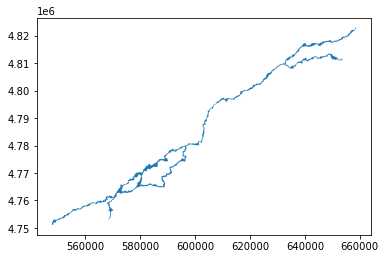

In [7]:
df_camiño_nortecosta.plot()
print(df_camiño_nortecosta.crs)

In [8]:
df_camiño_norteinterior = gpd.read_file('../../datasets/camiño/Camiño_Norte_Interior/25829/SHP/Territorio_historico.shp')
color = 'yellow'
df_camiño_norteinterior['color'] = color
df_camiño_norteinterior

,Disolve,geometry,color
0,0,"POLYGON ((584979.029 4755200.617, 584973.818 4...",yellow


epsg:25829


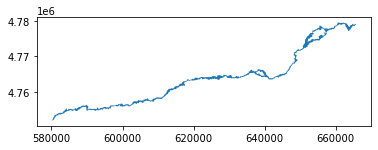

In [9]:
df_camiño_norteinterior.plot()
print(df_camiño_norteinterior.crs)

In [10]:
df_camiño_fisterra = gpd.read_file('../../datasets/camiño/CAMIÑO DE FISTERRA/001_FISTERRA_TRAZADO.shp')
df_camiño_fisterra = df_camiño_fisterra.to_crs('EPSG:25829')
color = 'yellow'
df_camiño_fisterra['color'] = color
df_camiño_fisterra

,Trazado,geometry,color
0,CAMINO FISTERRA,"POLYGON ((530788.656 4747781.089, 530790.975 4...",yellow


EPSG:25829


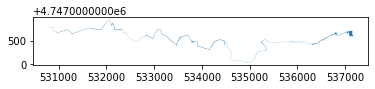

In [11]:
df_camiño_fisterra.plot()
print(df_camiño_fisterra.crs)

In [12]:
df_camiño_frances = gpd.read_file('../../datasets/camiño/Camiño_Frances/25829/SHP/AMBITO_BIC.shp')
color = 'orange'
df_camiño_frances['color'] = color
df_camiño_frances

,NOME,SUPERFICIE,geometry,color
0,AMBITO DA DELIMITACIÓN DO BIC CAMIÑO FRANCES,1.020873e+08,"POLYGON ((661304.897 4730285.476, 661293.964 4...",orange


epsg:25829


,NOME,SUPERFICIE,geometry,color
0,AMBITO DA DELIMITACIÓN DO BIC CAMIÑO FRANCES,1.020873e+08,"POLYGON ((661304.897 4730285.476, 661293.964 4...",orange


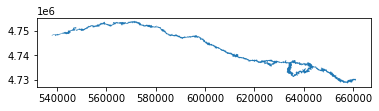

In [13]:

df_camiño_frances.plot()
print(df_camiño_frances.crs)
df_camiño_frances


In [14]:
df_camiño_portugues = gpd.read_file('../../datasets/camiño/CAMIÑO PORTUGUÉS/TRAZADOS/003_PORTUGUES_TRAZADO.shp')
df_camiño_portugues = df_camiño_portugues.to_crs('EPSG:25829')
color = 'blue'
df_camiño_portugues ['color'] = color
df_camiño_portugues


,Trazado,geometry,color
0,CAMINO PORTUGUES,"POLYGON ((537256.284 4747755.351, 537257.284 4...",blue


EPSG:25829


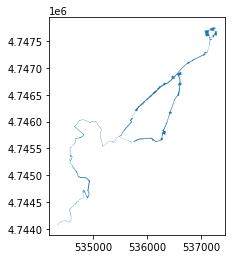

In [15]:
df_camiño_portugues.plot()
print(df_camiño_portugues.crs)


In [16]:
df_camiño_prata = gpd.read_file('../../datasets/camiño/RUTA DA PRATA/TRAZADOS/004_VIAPRATA_TRAZADO.shp')
df_camiño_prata = df_camiño_prata.to_crs('EPSG:25829')

color = 'purple'
df_camiño_prata['color'] = color
df_camiño_prata

,Trazado,geometry,color
0,RUTA DA PRATA,"POLYGON ((537256.284 4747755.351, 537257.284 4...",purple


EPSG:25829


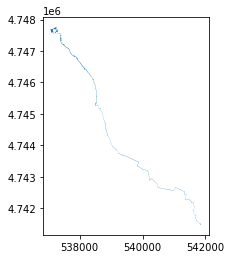

In [17]:
df_camiño_prata.plot()
print(df_camiño_prata.crs)


## mostro o mapa de Galicia cos concellos e os distintos camiños, o camiño portugués, vía da prata e fisterra non aparecen na mesma escala no mapa e non sei o motivo, xa que os calores e o CRS é o mesmo

<AxesSubplot:>

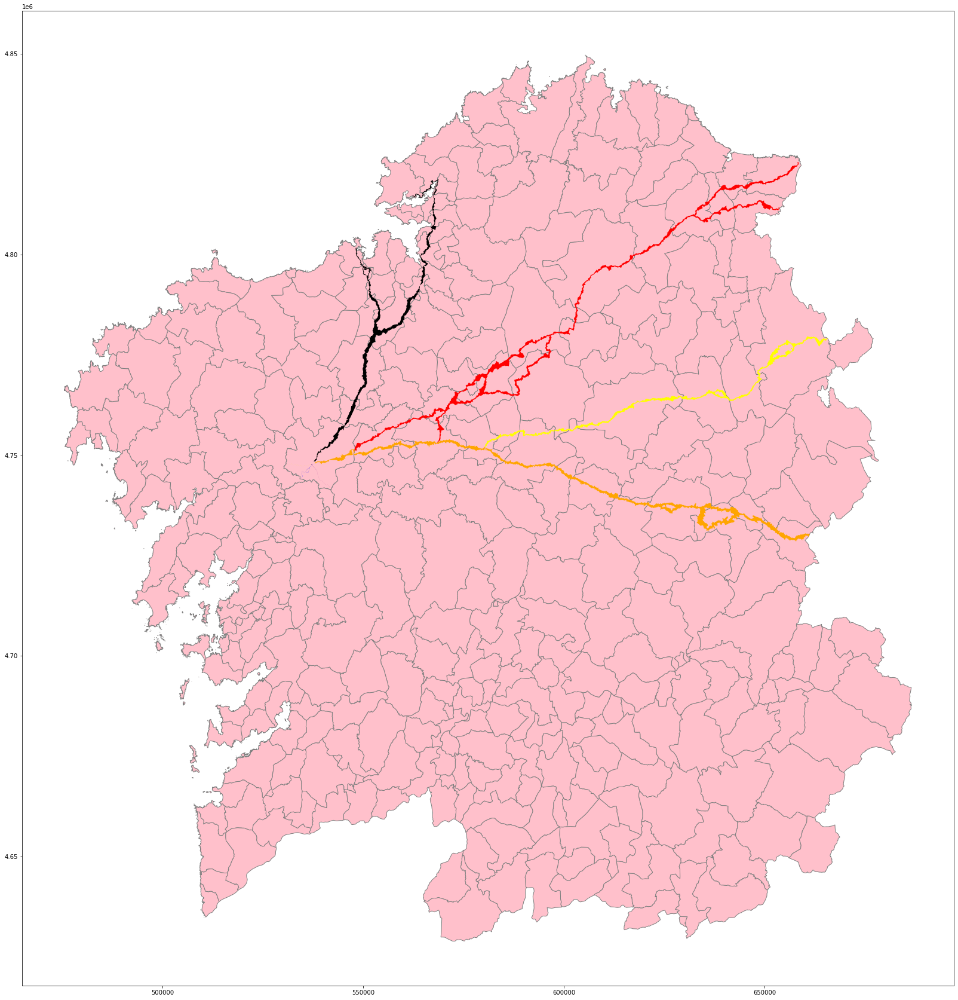

In [18]:
base = df_concello.plot(color='pink',figsize=(30,30),edgecolor='gray')

df_camiño_frances.plot(ax=base,linewidth=0.8,color=df_camiño_frances.color)
df_camiño_ingles.plot(ax=base,linewidth=0.8,color=df_camiño_ingles.color)
df_camiño_nortecosta.plot(ax=base,linewidth=0.8,color=df_camiño_nortecosta.color)
df_camiño_norteinterior.plot(ax=base,linewidth=0.8,color=df_camiño_norteinterior.color)
df_camiño_fisterra.plot(ax=base,linewidth=0.8,color=df_camiño_fisterra.color)
df_camiño_portugues.plot(ax=base,linewidth=0.8,color=df_camiño_portugues.color)
df_camiño_prata.plot(ax=base,linewidth=0.8,color=df_camiño_prata.color)

## Da péxina de turimo de Galicia obteño o listado de albergues, a súa latitude e lonxitude, ten a opción de descargar os datos para GPS e o descargalos quedan gardados nun CSV

In [19]:
albergues=pd.read_csv('../../datasets/camiño/galicia.csv', delimiter=',', names=['lat', 'lon', 'nome'])


albergues


,lat,lon,nome
0,-7.920739,43.066590,"""A CABANA"""
1,-9.188082,42.954480,"""A CASA DA FONTE"""
2,-8.608269,42.283157,"""A CASA DA HERBA"""
3,-7.451646,42.767853,"""A CASA DE CARMEN"""
4,-8.536836,42.861240,"""A CASA DE DORA"""
...,...,...,...
272,-7.326944,42.731110,"""VAL DE SAMOS"""
273,-7.749166,42.843918,"""VENTAS O CRUCEIRO I"""
274,-7.748805,42.843860,"""VENTAS O CRUCEIRO II"""
275,-8.164056,42.925415,"""VÍA LÁCTEA"""


In [20]:
albergues.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 277 entries, 0 to 276
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   lat     277 non-null    float64
 1   lon     277 non-null    float64
 2   nome    277 non-null    object 
dtypes: float64(2), object(1)
memory usage: 6.6+ KB


## Mostro o mapa de Galicia con folium, engado os concellos, os camiños e creo un cluster de marcas cos puntos dos albergues. Ademáis engado algúns puntos de interese

In [21]:
import pandas as pd

recomendacions = pd.DataFrame(
    { 'nome' : ['Catedral de Santiago','San Andrés de Teixido','Finisterra', 'O Cebreiro', 'Sarria'],
    'comentario' : ['O abrazo ó apostol','Outro lugar para peregrinar, vas de vivo ou de morto','Se queres podes segir un pouco máis ata a fin do mundo','Aquí o camiño entra en Galicia','Distancia mínima para obter a Compostelana']})
recomendacions

,nome,comentario
0,Catedral de Santiago,O abrazo ó apostol
1,San Andrés de Teixido,"Outro lugar para peregrinar, vas de vivo ou de..."
2,Finisterra,Se queres podes segir un pouco máis ata a fin ...
3,O Cebreiro,Aquí o camiño entra en Galicia
4,Sarria,Distancia mínima para obter a Compostelana


In [22]:
datos_camiño = []

#search_url = 'https://nominatim.openstreetmap.org/search'
#search_url = 'http://localhost:8080/search'
search_url = 'http://34.79.16.254/'

for idx, recomendacion in recomendacions.iterrows():
    search_payload = {'q': recomendacion.nome ,'format':'json'}
    search_response = requests.get(search_url,params=search_payload)
    latitude = search_response.json()[0]['lat']
    longitude = search_response.json()[0]['lon']
    osm_id = search_response.json()[0]['osm_id']

    datos_camiño.append([recomendacion.nome,latitude,longitude])

puntosdeinterese = pd.DataFrame(datos_camiño,columns=['nome','latitude','lonxitude'])
puntosdeinterese

,nome,latitude,lonxitude
0,Catedral de Santiago,42.8804004,-8.544627650101532
1,San Andrés de Teixido,43.7090405,-7.984102919268318
2,Finisterra,43.382336,-8.400904
3,O Cebreiro,42.7188437,-7.0574408
4,Sarria,42.7641051,-7.4007678905956436


In [23]:
puntosdeinterese = puntosdeinterese.merge(recomendacions)
puntosdeinterese

,nome,latitude,lonxitude,comentario
0,Catedral de Santiago,42.8804004,-8.544627650101532,O abrazo ó apostol
1,San Andrés de Teixido,43.7090405,-7.984102919268318,"Outro lugar para peregrinar, vas de vivo ou de..."
2,Finisterra,43.382336,-8.400904,Se queres podes segir un pouco máis ata a fin ...
3,O Cebreiro,42.7188437,-7.0574408,Aquí o camiño entra en Galicia
4,Sarria,42.7641051,-7.4007678905956436,Distancia mínima para obter a Compostelana


In [24]:
puntosdeinterese.to_csv('puntos_de_interese.csv',sep=';',index=None)

In [30]:
import folium.plugins

df_albergues = albergues.astype(str)

m = folium.Map(location=[43, -8.20],zoom_start=8, width=800, height=800)

# capa tiles
folium.TileLayer('Stamen Terrain').add_to(m)
folium.TileLayer('CartoDB Positron').add_to(m)

# capa concello
folium.GeoJson(df_concello, name='Concello').add_to(m)

# capa camiño francés
folium.GeoJson(df_camiño_frances).add_to(m)

# capa camiño inglés
folium.GeoJson(df_camiño_ingles).add_to(m)

# capa camiño norte costa
folium.GeoJson(df_camiño_nortecosta).add_to(m)

# capa camiño norte interior
folium.GeoJson(df_camiño_norteinterior).add_to(m)

# capa camiño portugues
folium.GeoJson(df_camiño_portugues).add_to(m)

# capa camiño fisterra
folium.GeoJson(df_camiño_fisterra).add_to(m)

# capa camiño vía da prata
folium.GeoJson(df_camiño_prata).add_to(m)



for idx, punto in puntosdeinterese.iterrows():
    folium.Marker([punto.latitude,punto.lonxitude],
    tooltip=punto.nome,
    popup=(f'{punto.nome} ({punto.comentario})'),
    icon=folium.Icon(color='pink',icon='flag', prefix='fa')). \
    add_to(m)

sw = puntosdeinterese[['latitude', 'lonxitude']].min().values.tolist()
ne = puntosdeinterese[['latitude', 'lonxitude']].max().values.tolist()

# clúster
marker_cluster = folium.plugins.MarkerCluster().add_to(m)

# capa albergues
for index, albergue in albergues.iterrows():

        latitude = albergue['lon']
        lonxitude = albergue['lat']
        nome = albergue['nome']
        folium.Marker([latitude,lonxitude],popup=nome,icon=folium.Icon(color='red',icon='hotel', prefix='fa')).add_to(marker_cluster)      
   
m.fit_bounds([sw, ne])      

folium.LayerControl().add_to(m)
m